### Installing Libraries

In [1]:
!pip install geopy
!pip install geocoder
!pip install folium

import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
import geocoder # to get coordinates

import requests # library to handle requests
from bs4 import BeautifulSoup # library to parse HTML and XML documents

from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

print("Libraries imported.")


/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/dhcrypto.py:16: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
/opt/conda/envs/Python-3.7-OpenCE/lib/python3.7/site-packages/secretstorage/util.py:25: CryptographyDeprecationWarning: int_from_bytes is deprecated, use int.from_bytes instead
  from cryptography.utils import int_from_bytes
     |████████████████████████████████| 98 kB 10.9 MB/s eta 0:00:01
/opt/conda/envs/Python-3

### Scraping Neighborhood data

In [19]:
address = 'Los Angeles, United States'
url = "https://en.wikipedia.org/wiki/List_of_districts_and_neighborhoods_of_Los_Angeles"
source = requests.get(url).text
soup = BeautifulSoup(source, 'lxml')
neighborhoodList = []

# -- append the data into the list

links = []
for row in soup.find_all("div", class_="div-col"):
    for item in row.select("a"):
        if item.has_attr('title'):
            neighborhoodList.append(item.text)

la_df = pd.DataFrame({"Neighborhood": neighborhoodList})
la_df.head(10)

,Neighborhood
0,Angelino Heights
1,Angeles Mesa
2,Angelus Vista
3,Arleta
4,Arlington Heights
5,Arts District
6,Atwater Village
7,Baldwin Hills
8,Baldwin Hills/Crenshaw
9,Baldwin Village


In [20]:
la_df.shape

(200, 1)

In [41]:
def get_latlng(neighborhood):
    # initialize your variable to None
    lat_lng_coords = None
    # loop until you get the coordinates
    while(lat_lng_coords is None):
        g = geocoder.arcgis('{}, Los Angeles, United States'.format(neighborhood))
        lat_lng_coords = g.latlng
    return lat_lng_coords

In [49]:
coordinates = [ get_latlng(neighborhood) for neighborhood in la_df["Neighborhood"].tolist()]

In [43]:
coordinates

[[34.07029000000006, -118.25479999999999],
 [18.285830000000033, -66.80088999999998],
 [34.08757488206556, -118.26715643600681],
 [34.24905000000007, -118.43348999999995],
 [34.03989000000007, -118.32515999999998],
 [34.04195200000004, -118.23638499999998],
 [34.11970000000008, -118.25886999999994],
 [34.021570000000054, -118.36764999999997],
 [34.01042800000005, -118.33677599999999],
 [34.07044548680411, -118.20070975126488],
 [34.07044548680411, -118.20070975126488],
 [34.10915025473649, -118.32045034087673],
 [34.08361000000008, -118.43482999999998],
 [34.093863023638136, -118.42912206311348],
 [34.09653268819107, -118.40329514585207],
 [34.11793000000006, -118.44608999999997],
 [34.09544836979449, -118.42608686997163],
 [34.07551200000006, -118.35572899999994],
 [34.063720000000046, -118.26459999999997],
 [34.05138000000005, -118.40132999999997],
 [34.04004000000003, -118.21049999999997],
 [34.06626000000006, -118.47032999999999],
 [33.98805503453503, -118.27720988461618],
 [33.988

In [50]:
df_coords = pd.DataFrame(coords, columns=['Latitude', 'Longitude'])
# Merge the coordinates into the original dataframe
la_df['Latitude'] = df_coords['Latitude']
la_df['Longitude'] = df_coords['Longitude']
print(la_df.shape)
la_df

(200, 3)


,Neighborhood,Latitude,Longitude
0,Angelino Heights,34.070290,-118.254800
1,Angeles Mesa,32.764074,-116.986171
2,Angelus Vista,34.087575,-118.267156
3,Arleta,34.249050,-118.433490
4,Arlington Heights,34.039890,-118.325160
5,Arts District,34.041952,-118.236385
6,Atwater Village,34.119700,-118.258870
7,Baldwin Hills,34.021570,-118.367650
8,Baldwin Hills/Crenshaw,34.010428,-118.336776
9,Baldwin Village,34.070445,-118.200710


In [52]:
la_df.dtypes

Neighborhood     object
Latitude        float64
Longitude       float64
dtype: object

In [53]:
la_df.to_csv("kl_df.csv", index=False)

In [54]:
address = 'Los Angeles'

geolocator = Nominatim(user_agent = "ExploreLA")
LA_location = geolocator.geocode(address)
LA_latitude = LA_location.latitude
LA_longitude = LA_location.longitude

print('The geograpical coordinates of Los Angeles are {}, {}.'.format(LA_latitude, LA_longitude))

The geograpical coordinates of Los Angeles are 34.0536909, -118.242766.


### Using folium to plot neighbourhoods on the map

In [57]:
mapLA = folium.Map(
    location=[LA_latitude, LA_longitude], 
    tiles='Stamen Toner', 
    zoom_start=10, 
)

# add markers to map
for lat, lng, neighborhood in zip(la_df['Latitude'], la_df['Longitude'], la_df['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html = True)
    folium.Marker(
        [lat, lng],
        popup = label,
    ).add_to(mapLA)

In [59]:
mapLA

### Using Foursquare API

In [61]:
CLIENT_ID = 'WEN25BJ1WKZKS0LTYGLOFOSQF5U1NH2MPFBX3Q33FTD23Z0Y' 
CLIENT_SECRET = 'ECSJJ0XFAZPFEEBZCSLBPG5EUCRL3CKNKZWYELTEOFBPJZAW' 
VERSION = '20180605' 


radius=1000
LIMIT=200

In [62]:
def getVeneus(neighborhood, latitude, longitude, category=None, radius=1000):
    venues_list = []
    params = {
        "client_id": CLIENT_ID,
        "client_secret": CLIENT_SECRET,
        "v": VERSION,
        "ll": "{},{}".format(latitude, longitude),
        "radius": radius,
        "limit": LIMIT,
    }
    url = 'https://api.foursquare.com/v2/venues/search'    
    results = requests.get(url, params=params).json()

    if not results["response"]:
        return []

    for v in results["response"]['venues']:
        if not v['categories']:
            continue
        venues_list.append([
            neighborhood,
            latitude, 
            longitude, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng'],
            v['categories'][0]["name"]
        ])
    return venues_list

In [63]:
def getNearbyVenues(neighborhoods, latitudes, longitudes, category=None, radius=1000):
    
    venues_list=[]
    for neig, lat, lng in zip(neighborhoods, latitudes, longitudes):
        results = getVeneus(neig, lat, lng, category=category, radius=radius)
        venues_list += results
        
    if not venues_list:
        print("venue list is empty")
        return []
    
    venues_data = pd.DataFrame(venue for venue in venues_list)
    venues_data.columns = [
        'Neighborhood', 
        'Neighborhood Latitude', 
        'Neighborhood Longitude', 
        'Venue', 
        'Venue Latitude', 
        'Venue Longitude',
        'Venue Category',
    ]
    
    return venues_data

In [65]:
venues_df = getNearbyVenues(
    neighborhoods=la_df['Neighborhood'],
    latitudes=la_df['Latitude'],
    longitudes=la_df['Longitude'],
)

In [67]:
venues_df.drop_duplicates(keep="first", inplace=True)
venues_df.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Angelino Heights,34.07029,-118.2548,"Michael Jackson's ""Thriller"" House (and Tree)",34.069557,-118.254599,Historic Site
1,Angelino Heights,34.07029,-118.2548,Halliwell Manor,34.069329,-118.254165,Performing Arts Venue
2,Angelino Heights,34.07029,-118.2548,LIVIN THE LIFE,34.070012,-118.257075,Record Shop
3,Angelino Heights,34.07029,-118.2548,1343 Calumet,34.068783,-118.254886,Residential Building (Apartment / Condo)
4,Angelino Heights,34.07029,-118.2548,Rico's Tacos,34.070252,-118.250261,Food Truck


In [69]:
def get_categories():
    try:
        with open("categories.json") as data:
            categories = json.load(data)
    except IOError:
        url = 'https://api.foursquare.com/v2/venues/categories'
        params = {
            "client_id": CLIENT_ID,
            "client_secret": CLIENT_SECRET,
            "v": VERSION,
        }
        categories = requests.get(url, params=params).json()["response"]["categories"]
    return categories

In [70]:
def collect_categories(node, categories):
    categories.append(node["name"])
    if not node["categories"]:
        return
    for sub_node in node['categories']:
        collect_categories(sub_node, categories)
categories_list = {}
for i in get_categories():
    categories = []
    collect_categories(i, categories)
    categories_list[i["name"]] = categories

In [77]:
venueCat = []

for venue_category in venues_df["Venue Category"]:
    for key in categories_list.keys():
        if venue_category in categories_list[key]:
            venueCat.append(key)

venues_df["General Venue Category"] = venueCat

venues_df.head(20)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,General Venue Category
0,Angelino Heights,34.07029,-118.2548,"Michael Jackson's ""Thriller"" House (and Tree)",34.069557,-118.254599,Historic Site,Arts & Entertainment
1,Angelino Heights,34.07029,-118.2548,Halliwell Manor,34.069329,-118.254165,Performing Arts Venue,Arts & Entertainment
2,Angelino Heights,34.07029,-118.2548,LIVIN THE LIFE,34.070012,-118.257075,Record Shop,Shop & Service
3,Angelino Heights,34.07029,-118.2548,1343 Calumet,34.068783,-118.254886,Residential Building (Apartment / Condo),Residence
4,Angelino Heights,34.07029,-118.2548,Rico's Tacos,34.070252,-118.250261,Food Truck,Food
5,Angelino Heights,34.07029,-118.2548,Ridge Wy,34.071826,-118.253959,Trail,Outdoors & Recreation
6,Angelino Heights,34.07029,-118.2548,Lento Market,34.070979,-118.250862,Market,Shop & Service
7,Angelino Heights,34.07029,-118.2548,Bar Henry,34.069062,-118.250465,Cocktail Bar,Nightlife Spot
8,Angelino Heights,34.07029,-118.2548,Tacos Los Primos,34.066974,-118.252916,Food Truck,Food
9,Angelino Heights,34.07029,-118.2548,만수,34.057517,-118.304496,Korean Restaurant,Food


In [78]:
venueList = venues_df["General Venue Category"].unique()
venueList

array(['Arts & Entertainment', 'Shop & Service', 'Residence', 'Food',
       'Outdoors & Recreation', 'Nightlife Spot',
       'Professional & Other Places', 'Travel & Transport',
       'College & University', 'Event'], dtype=object)

In [80]:
venues_df.drop(
    venues_df[
        (venues_df["General Venue Category"] == 'Professional & Other Places') |
        (venues_df["General Venue Category"] == 'Residence') |
        (venues_df["General Venue Category"] == 'College & University') |
        (venues_df["General Venue Category"] == 'Arts & Entertainment') |
        (venues_df["General Venue Category"] == 'Travel & Transport') |
        (venues_df["General Venue Category"] == 'Event') |
        (venues_df["General Venue Category"] == 'Shop & Service') 
    ].index,
    axis=0,
    inplace=True,
)
 
venues_df.head(10)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,General Venue Category
4,Angelino Heights,34.07029,-118.2548,Rico's Tacos,34.070252,-118.250261,Food Truck,Food
5,Angelino Heights,34.07029,-118.2548,Ridge Wy,34.071826,-118.253959,Trail,Outdoors & Recreation
7,Angelino Heights,34.07029,-118.2548,Bar Henry,34.069062,-118.250465,Cocktail Bar,Nightlife Spot
8,Angelino Heights,34.07029,-118.2548,Tacos Los Primos,34.066974,-118.252916,Food Truck,Food
9,Angelino Heights,34.07029,-118.2548,만수,34.057517,-118.304496,Korean Restaurant,Food
11,Angelino Heights,34.07029,-118.2548,Thunderbolt,34.066298,-118.253917,Restaurant,Food
14,Angelino Heights,34.07029,-118.2548,W. Edgeware Rd.,34.071707,-118.253693,Trail,Outdoors & Recreation
15,Angelino Heights,34.07029,-118.2548,El Toritos,34.068463,-118.257507,Cocktail Bar,Nightlife Spot
16,Angelino Heights,34.07029,-118.2548,THE D3EP HAU$,34.069892,-118.257090,Lounge,Nightlife Spot
18,Angelino Heights,34.07029,-118.2548,Tacos La Movidita (aka Bellevue Steakhouse),34.069535,-118.258367,Steakhouse,Food


In [83]:

colorDict = {
    'Outdoors & Recreation': 'cadetblue',
    'Food': 'darkgreen',
    'Nightlife Spot': 'beige',
}

In [84]:
from folium.plugins import MarkerCluster

venueMap = folium.Map(
    location=[LA_latitude, LA_longitude], 
    tiles='Stamen Toner', 
    zoom_start=10
)

markCluster = MarkerCluster().add_to(venueMap)

for lat, lng, cat in zip(venues_df['Venue Latitude'],
                         venues_df['Venue Longitude'],
                         venues_df['General Venue Category']):  
    if cat in colorDict:
        folium.Marker(
            location=[lat, lng],
            icon=folium.Icon(color=colorDict[cat]),
        ).add_to(markCluster)

In [85]:
venueMap

In [86]:
venCountdf = venues_df.groupby(["General Venue Category"]).count()
venCountdf.reset_index(inplace=True)
venCountdf.set_index(pd.Index([0, 1, 2]))

venCountdf.drop(
    columns=[
        "Neighborhood",
        "Neighborhood Latitude",
        "Neighborhood Longitude",
        "Venue",
        "Venue Latitude",
        "Venue Longitude"
    ],
    inplace=True
)

venCountdf.rename(
    columns={"Venue Category": "Number of Categories"},
    inplace=True
)

venCountdf.sort_values(
    by="Number of Categories",
    ascending=False
)

,General Venue Category,Number of Categories
0,Food,3545
2,Outdoors & Recreation,1808
1,Nightlife Spot,815


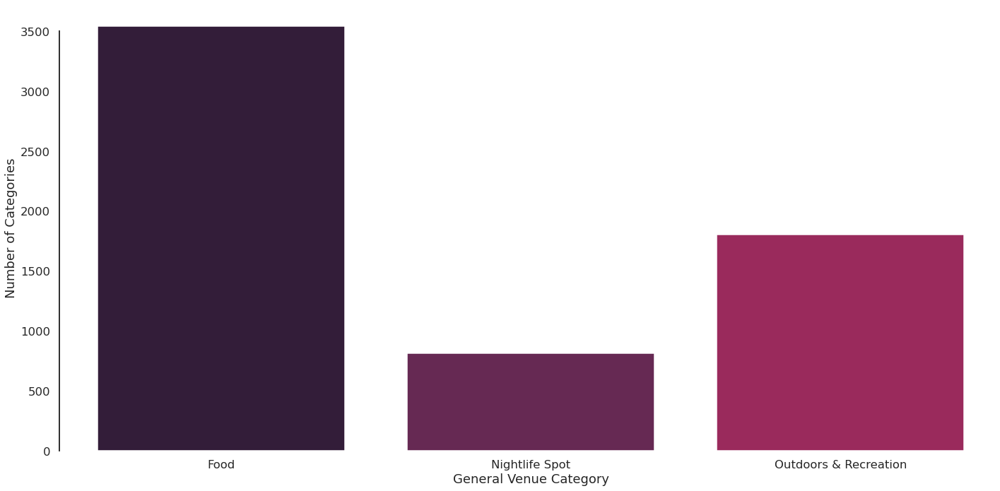

In [90]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import seaborn as sns

plt.figure(figsize=(20, 10))

sns.set(style="white", context="talk", palette="rocket")

sns.barplot(
    data=venues_df,
    x=venCountdf["General Venue Category"],
    y=venCountdf["Number of Categories"],
)

sns.despine(offset=10, trim=True, bottom=True)
plt.tight_layout(h_pad=2)


### K-means Clustering

In [92]:
venCatDF = venues_df.copy()

for category in venueList:
    venCatDF[category] = np.nan

for i in range(len(venueList)):
    for index, row in venCatDF.iterrows():
        venCatDF.loc[index, venueList[i]] = venues_df[
            (venues_df["Neighborhood"] == row["Neighborhood"])&
            (venues_df["General Venue Category"] == venueList[i])
        ].count()[0]

venCatDF

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,General Venue Category,Arts & Entertainment,Shop & Service,Residence,Food,Outdoors & Recreation,Nightlife Spot,Professional & Other Places,Travel & Transport,College & University,Event
4,Angelino Heights,34.070290,-118.254800,Rico's Tacos,34.070252,-118.250261,Food Truck,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
5,Angelino Heights,34.070290,-118.254800,Ridge Wy,34.071826,-118.253959,Trail,Outdoors & Recreation,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
7,Angelino Heights,34.070290,-118.254800,Bar Henry,34.069062,-118.250465,Cocktail Bar,Nightlife Spot,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
8,Angelino Heights,34.070290,-118.254800,Tacos Los Primos,34.066974,-118.252916,Food Truck,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
9,Angelino Heights,34.070290,-118.254800,만수,34.057517,-118.304496,Korean Restaurant,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
11,Angelino Heights,34.070290,-118.254800,Thunderbolt,34.066298,-118.253917,Restaurant,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
14,Angelino Heights,34.070290,-118.254800,W. Edgeware Rd.,34.071707,-118.253693,Trail,Outdoors & Recreation,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
15,Angelino Heights,34.070290,-118.254800,El Toritos,34.068463,-118.257507,Cocktail Bar,Nightlife Spot,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
16,Angelino Heights,34.070290,-118.254800,THE D3EP HAU$,34.069892,-118.257090,Lounge,Nightlife Spot,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
18,Angelino Heights,34.070290,-118.254800,Tacos La Movidita (aka Bellevue Steakhouse),34.069535,-118.258367,Steakhouse,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0


In [93]:
kclusters = 5
clusterDF = venCatDF.drop(
    columns=["Neighborhood", "Neighborhood Latitude", "Neighborhood Longitude",'Venue',"Venue Latitude",
             'Venue Longitude', 'Venue Category','General Venue Category']
)
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(clusterDF)

In [94]:
mergedLADF = venCatDF
mergedLADF.insert(0, 'Cluster_Labels', kmeans.labels_)
mergedLADF.head() # check the last columns!

,Cluster_Labels,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,General Venue Category,Arts & Entertainment,Shop & Service,Residence,Food,Outdoors & Recreation,Nightlife Spot,Professional & Other Places,Travel & Transport,College & University,Event
4,0,Angelino Heights,34.07029,-118.2548,Rico's Tacos,34.070252,-118.250261,Food Truck,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
5,0,Angelino Heights,34.07029,-118.2548,Ridge Wy,34.071826,-118.253959,Trail,Outdoors & Recreation,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
7,0,Angelino Heights,34.07029,-118.2548,Bar Henry,34.069062,-118.250465,Cocktail Bar,Nightlife Spot,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
8,0,Angelino Heights,34.07029,-118.2548,Tacos Los Primos,34.066974,-118.252916,Food Truck,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0
9,0,Angelino Heights,34.07029,-118.2548,만수,34.057517,-118.304496,Korean Restaurant,Food,0.0,0.0,0.0,17.0,9.0,10.0,0.0,0.0,0.0,0.0


In [95]:
mergedLADF['Cluster_Labels'].unique()

array([0, 1, 4, 2, 3], dtype=int32)

In [96]:
# create map
mapClusters = folium.Map(location = [LA_latitude, LA_longitude], tiles='Stamen Toner', zoom_start=10)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(mergedLADF['Neighborhood Latitude'], 
                                  mergedLADF['Neighborhood Longitude'], 
                                  mergedLADF['Neighborhood'], 
                                  mergedLADF['Cluster_Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.9
    ).add_to(mapClusters)

In [97]:
mapClusters

In [99]:
def mostCommonVenue(df):
    
    num_top_venues = 6

    indicators = ['st', 'nd', 'rd']

    # create columns according to number of top venues
    areaColumns = ['Neighborhood','Cluster Label']
    freqColumns = []
    for ind in np.arange(num_top_venues):
        try:
            freqColumns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
        except:
            freqColumns.append('{}th Most Common Venue'.format(ind+1))
    columns = areaColumns+freqColumns

    # create a new dataframe
    neighborhoods_venues_sorted = pd.DataFrame(columns=columns)

    neighborhoods_venues_sorted['Neighborhood'] = df['Neighborhood']
    neighborhoods_venues_sorted['Cluster Label'] = df['Cluster_Labels']

    for ind in np.arange(df.shape[0]):
        row_categories = df.iloc[ind, :].iloc[9:]
    #     print(row_categories)
        row_categories_sorted = row_categories.sort_values(ascending=False)
        neighborhoods_venues_sorted.iloc[ind, 2:] = row_categories_sorted.index.values[0:num_top_venues]

    neighborhoods_venues_sorted.drop_duplicates(keep="first", inplace=True)
    neighborhoods_venues_sorted.reset_index(inplace=True,drop=True)
    return neighborhoods_venues_sorted
mostCommonV = mostCommonVenue(mergedLADF)
mostCommonV

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Angelino Heights,0,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
1,Angeles Mesa,1,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
2,Angelus Vista,4,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
3,Arleta,0,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
4,Arlington Heights,0,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
5,Arts District,4,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
6,Atwater Village,4,Food,Event,College & University,Travel & Transport,Professional & Other Places,Nightlife Spot
7,Baldwin Hills,0,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
8,Baldwin Hills/Crenshaw,2,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
9,Baldwin Village,0,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport


In [100]:
cluster1DF = mergedLADF.loc[
    mergedLADF['Cluster_Labels'] == 0,
    mergedLADF.columns[list(range(0, mergedLADF.shape[1]))]
]
cluster1DFMost = mostCommonVenue(cluster1DF)
cluster1DFMost.drop('Cluster Label', inplace=True,axis=1)
cluster1DFMost

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Angelino Heights,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
1,Arleta,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
2,Arlington Heights,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
3,Baldwin Hills,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
4,Baldwin Village,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
5,Baldwin Vista,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
6,Beverly Hills Post Office,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
7,Beverly Park,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
8,Brentwood,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
9,Brentwood Circle,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport


In [101]:
cluster2DF = mergedLADF.loc[
    mergedLADF['Cluster_Labels'] == 1,
    mergedLADF.columns[list(range(0, mergedLADF.shape[1]))]
]
cluster2DFMost = mostCommonVenue(cluster2DF)
cluster2DFMost.drop('Cluster Label', inplace=True,axis=1)
cluster2DFMost

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Angeles Mesa,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
1,Benedict Canyon,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
2,Beverly Glen,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
3,Beverly Grove,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
4,Carthay,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
5,Crestwood Hills,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
6,Edendale,Outdoors & Recreation,Nightlife Spot,Food,Event,College & University,Travel & Transport
7,Franklin Hills,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
8,Gallery Row,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
9,Hermon,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport


In [102]:
cluster3DF = mergedLADF.loc[
    mergedLADF['Cluster_Labels'] == 2,
    mergedLADF.columns[list(range(0, mergedLADF.shape[1]))]
]
cluster3DFMost = mostCommonVenue(cluster3DF)
cluster3DFMost.drop('Cluster Label', inplace=True,axis=1)
cluster3DFMost

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Baldwin Hills/Crenshaw,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
1,Boyle Heights,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
2,Bunker Hill,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
3,Chinatown,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
4,Crenshaw,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
5,Eagle Rock,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
6,Echo Park,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
7,Elysian Heights,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
8,Elysian Valley,Food,Outdoors & Recreation,Event,College & University,Travel & Transport,Professional & Other Places
9,Harvard Heights,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport


In [103]:
cluster4DF = mergedLADF.loc[
    mergedLADF['Cluster_Labels'] == 3,
    mergedLADF.columns[list(range(0, mergedLADF.shape[1]))]
]
cluster4DFMost = mostCommonVenue(cluster4DF)
cluster4DFMost.drop('Cluster Label', inplace=True,axis=1)
cluster4DFMost

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Elysian Park,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
1,Griffith Park,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
2,Lake View Terrace,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
3,Mandeville Canyon,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
4,Marina Peninsula,Outdoors & Recreation,Nightlife Spot,Food,Event,College & University,Travel & Transport
5,Shadow Hills,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
6,Solano Canyon,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport


In [104]:
cluster5DF = mergedLADF.loc[
    mergedLADF['Cluster_Labels'] == 4,
    mergedLADF.columns[list(range(0, mergedLADF.shape[1]))]
]
cluster5DFMost = mostCommonVenue(cluster5DF)
cluster5DFMost.drop('Cluster Label', inplace=True,axis=1)
cluster5DFMost

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue
0,Angelus Vista,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
1,Arts District,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
2,Atwater Village,Food,Event,College & University,Travel & Transport,Professional & Other Places,Nightlife Spot
3,Beachwood Canyon,Outdoors & Recreation,Nightlife Spot,Food,Event,College & University,Travel & Transport
4,"Bel Air, Bel-Air or Bel Air Estates",Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
5,Beverly Crest,Outdoors & Recreation,Nightlife Spot,Food,Event,College & University,Travel & Transport
6,Beverlywood,Food,Outdoors & Recreation,Nightlife Spot,Event,College & University,Travel & Transport
7,Broadway-Manchester,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
8,Cahuenga Pass,Outdoors & Recreation,Food,Nightlife Spot,Event,College & University,Travel & Transport
9,Castle Heights,Food,Nightlife Spot,Outdoors & Recreation,Event,College & University,Travel & Transport
